In [1]:
fig_dir = '/home/jovyan/projects/P38_Adult-heart-RNA_celltype-annotation/notebooks/Revision/figures'

## Import modules

In [2]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

import numpy as np
import numpy.random as random
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import sctk

In [3]:
import session_info
session_info.show()

In [8]:
sc.settings.verbosity = 1          # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=300, color_map = 'RdPu', facecolor='white')

## Read in data

In [5]:
adata = sc.read_h5ad('/nfs/team205/heart/anndata_objects/8regions/RNA_adult-8reg_full_raw_cellstate-annotated.h5ad')
adata

AnnData object with n_obs × n_vars = 704296 × 32732
    obs: 'sangerID', 'combinedID', 'donor', 'donor_type', 'region', 'region_finest', 'age', 'gender', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'flushed', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'batch_key', 'leiden_scVI', 'cell_type', 'cell_state_HCAv1', 'cell_state_scNym', 'cell_state_scNym_confidence', 'cell_state', 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'n_counts', '_scvi_batch', '_scvi_labels', 'clus20', 'doublet_cls', 'original_or_new', 'batch', 'scANVI_predictions', 'leiden_scArches'
    var: 'gene_name-new', 'gene_name_scRNA-0-original', 'gene_name_snRNA-1-original', 'gene_name_multiome-2-original'
    uns: 'age_colors', 'cell_or_nuclei_colors', 'cell_state_colors', 'cell_type_colors', 'donor_colors', 'donor_t

In [6]:
# reorder the regions
adata.obs['region'].cat.reorder_categories([
    'SAN','AVN','RA','LA','RV','LV','SP','AX',
], inplace=True)

In [6]:
len(set(adata.obs['cell_state']))-1 # '-1' for unclassified

75

In [7]:
adata.obs['modality'].value_counts()

snRNA           357538
Multiome-RNA    211060
scRNA           135698
Name: modality, dtype: int64

In [8]:
len(set(adata.obs['donor']))

22

In [9]:
adata.obs['cell_type'].value_counts()

Ventricular Cardiomyocyte     190710
Fibroblast                    138055
Endothelial cell              131505
Mural cell                    104593
Myeloid                        51426
Atrial Cardiomyocyte           45911
Lymphoid                       24922
Neural cell                     6622
Adipocyte                       6347
Mast cell                       1853
Lymphatic Endothelial cell      1295
Mesothelial cell                1057
Name: cell_type, dtype: int64

In [5]:
pd.crosstab(adata.obs['cell_type'],adata.obs['modality'])

modality,Multiome-RNA,scRNA,snRNA
cell_type,,,
Atrial Cardiomyocyte,19509,826,25576
Ventricular Cardiomyocyte,47782,1098,141830
Fibroblast,63789,3163,71103
Endothelial cell,26288,80398,24819
Lymphatic Endothelial cell,618,231,446
Mural cell,14794,22641,67158
Mesothelial cell,213,195,649
Neural cell,2680,497,3445
Adipocyte,2502,1,3844


## UMAPs

In [21]:
sc.settings.set_figure_params(dpi=300, facecolor=None, color_map = 'RdPu',)

<AxesSubplot:title={'center':'cell_state'}, xlabel='UMAP1', ylabel='UMAP2'>

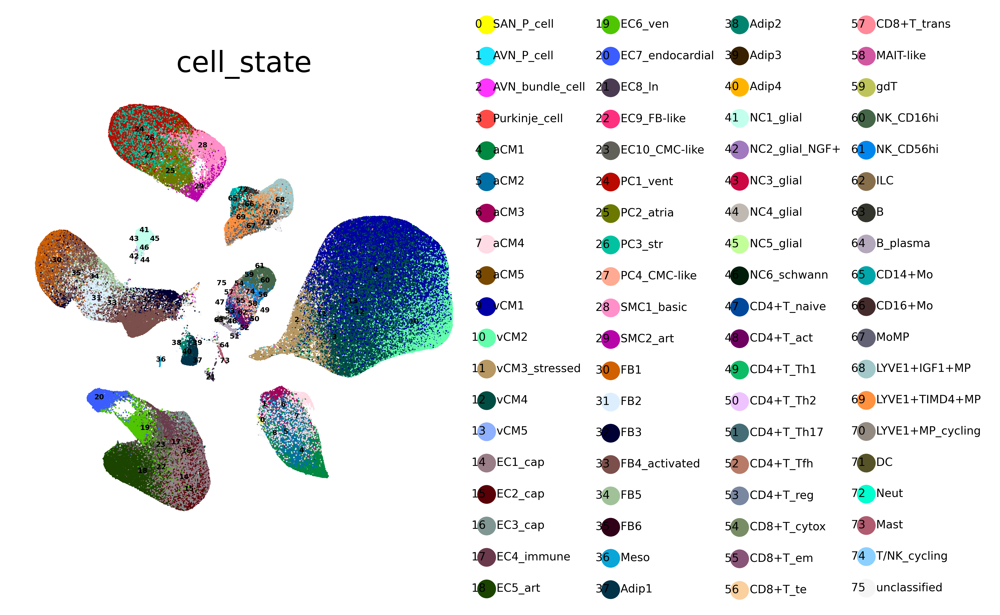

In [24]:
adata.uns["cell_state_colors"][list(adata.obs['cell_state'].cat.categories).index('unclassified')]='whitesmoke'

sctk.plot_embedding(adata, groupby='cell_state', basis='umap', color=None, annot=True, frameon=False,legend_fontsize=5,size=2,
                   save='./figures/UMAP_global_cellstate.pdf')

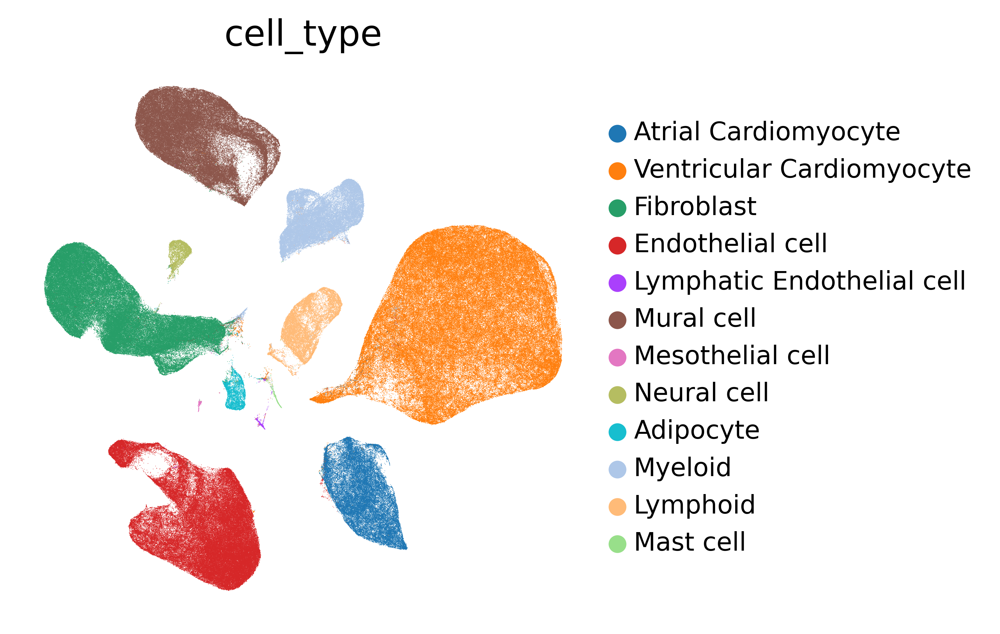

In [9]:
sc.pl.umap(adata, color='cell_type', frameon=False, legend_fontsize=10,size=0.2)

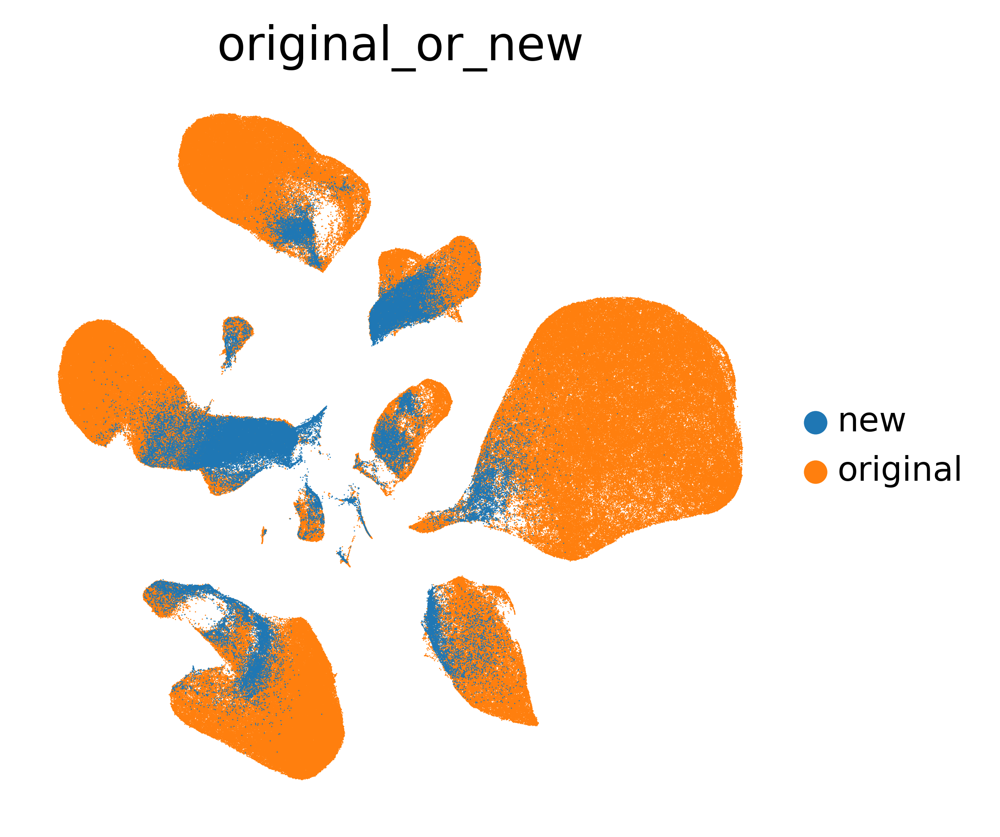

In [34]:
sc.pl.umap(adata, color='original_or_new', frameon=False, legend_fontsize=10,size=0.5)

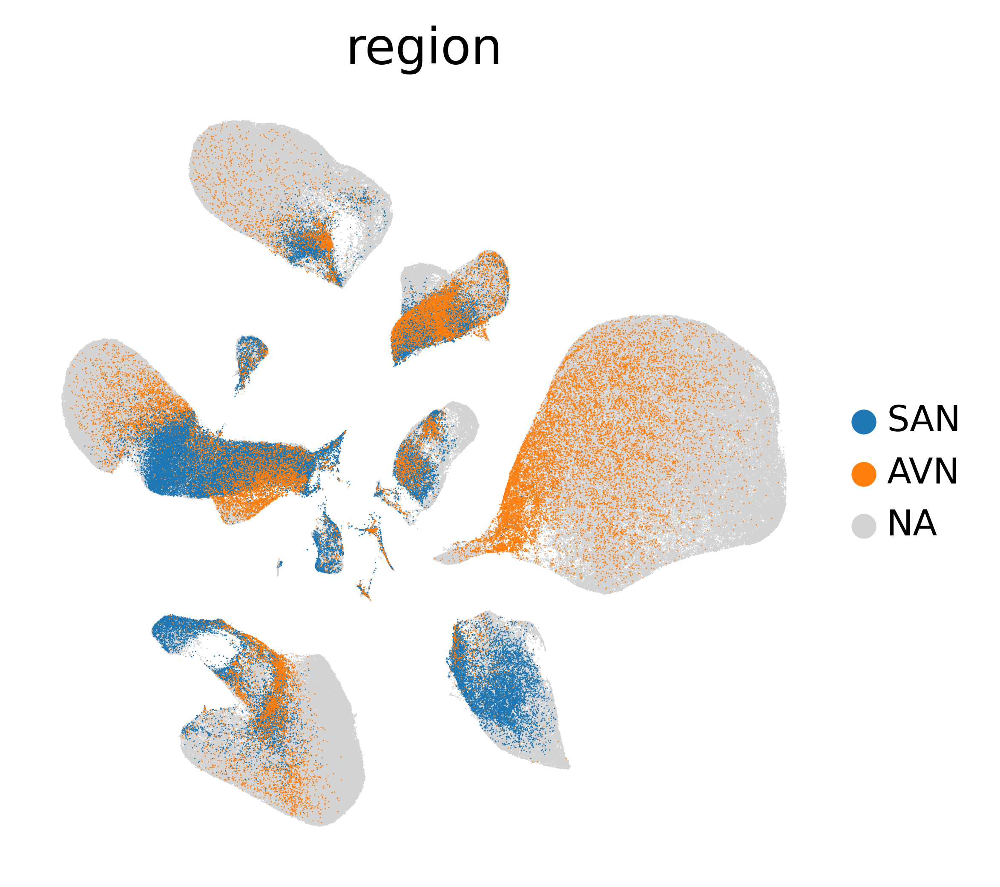

In [33]:
sc.pl.umap(adata, color='region', groups=['SAN','AVN'], frameon=False, legend_fontsize=10,size=0.5)

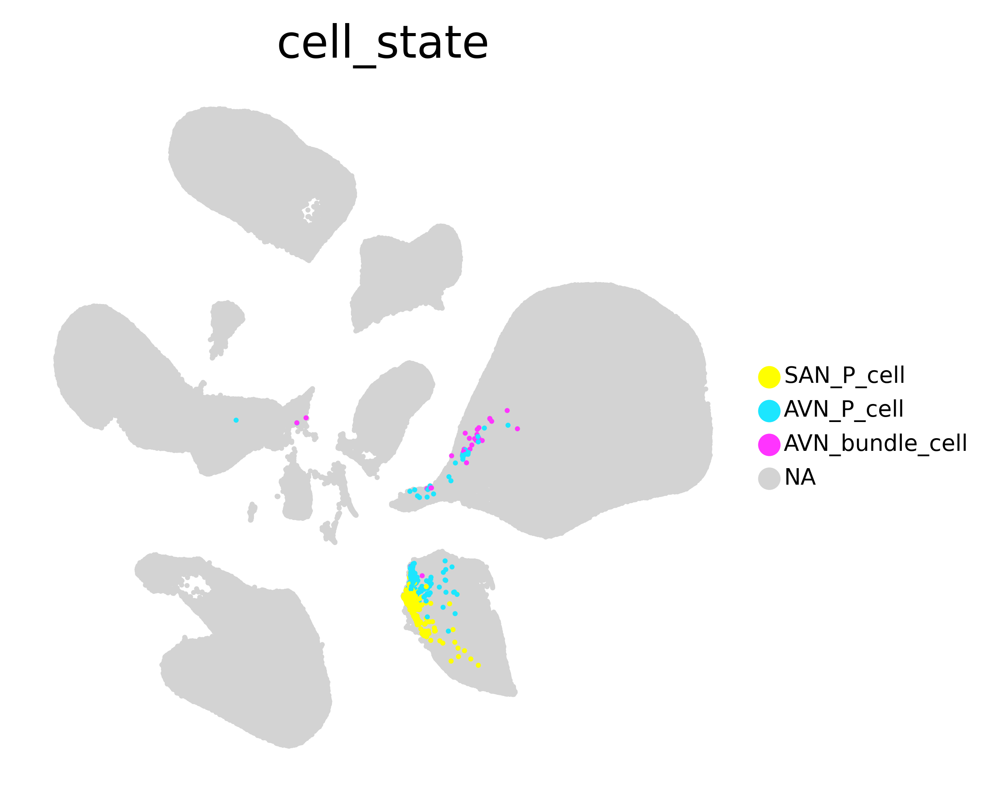

In [12]:
sc.pl.umap(adata, color=['cell_state'],groups=['SAN_P_cell','AVN_P_cell','AVN_bundle_cell',], legend_fontsize=7, frameon=False, size=10,
           legend_fontweight='normal',save='_global_cellstate_onlyCCS.png') # 
# 'NC2_glial_NGF+','FB4_activated', 'vCM3_stressed',

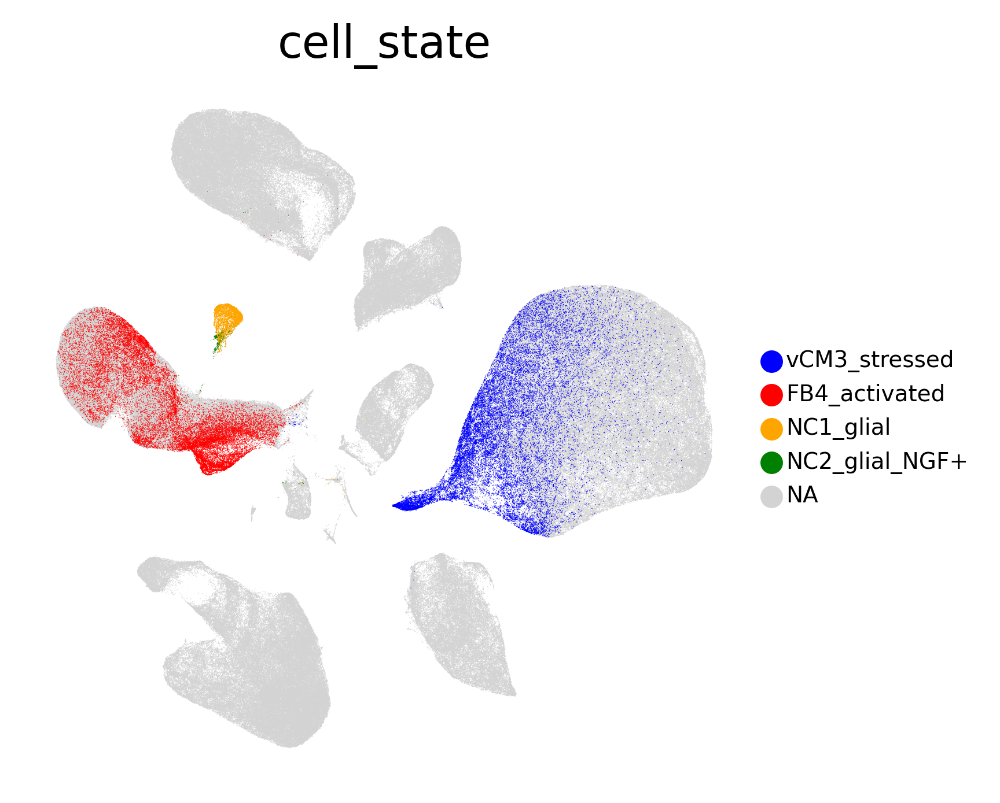

In [20]:
adata.uns["cell_state_colors"][list(adata.obs['cell_state'].cat.categories).index('NC1_glial')]='orange'
adata.uns["cell_state_colors"][list(adata.obs['cell_state'].cat.categories).index('NC2_glial_NGF+')]='green'
adata.uns["cell_state_colors"][list(adata.obs['cell_state'].cat.categories).index('FB4_activated')]='red'
adata.uns["cell_state_colors"][list(adata.obs['cell_state'].cat.categories).index('vCM3_stressed')]='blue'
adata.uns["cell_state_colors"][list(adata.obs['cell_state'].cat.categories).index('EC7_endocardial')]='salmon'

sc.pl.umap(adata, color=['cell_state'],groups=[
    'NC1_glial',
              'NC2_glial_NGF+',
    'FB4_activated',
   'vCM3_stressed',
# 'EC7_endocardial'
], legend_fontsize=7, frameon=False, size=0.2,
               legend_fontweight='normal',save='_global_cellstate_focused.pdf',
              ) # 

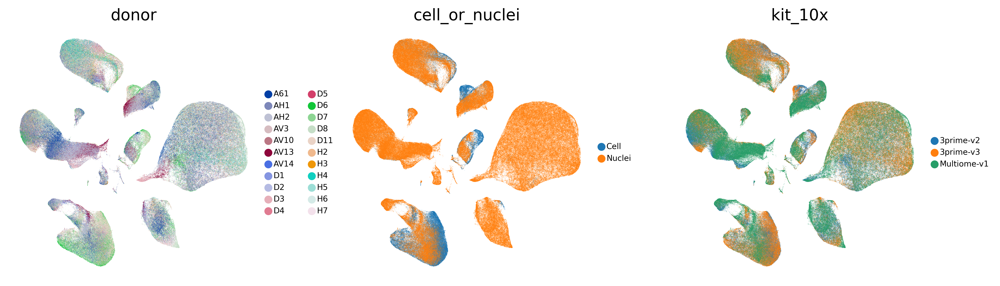

In [16]:
sc.settings.set_figure_params(dpi=200, facecolor=None, color_map = 'RdPu',)
sc.pl.umap(adata, color=['donor','cell_or_nuclei','kit_10x'], legend_fontsize=7, frameon=False, 
           legend_fontweight='bold',
          save='_global_batches.pdf')

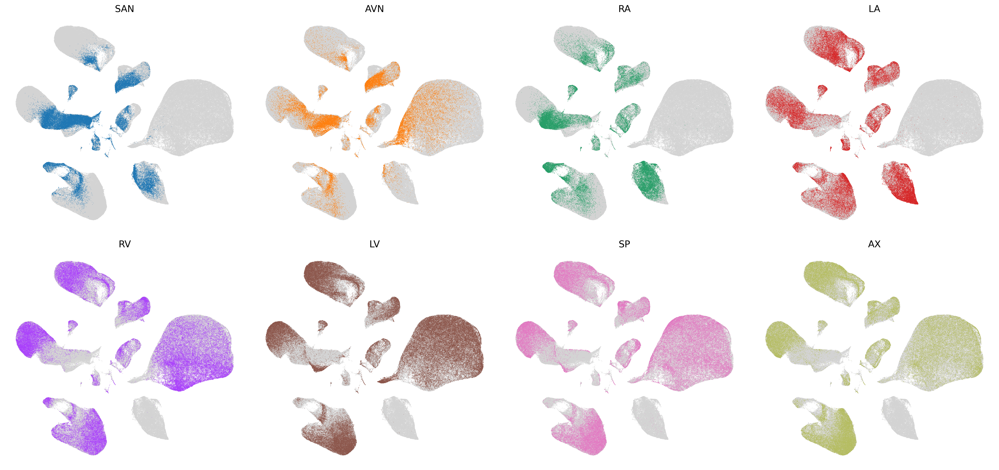

In [19]:
# region plot
fig, axs = plt.subplots(nrows=2, ncols=4, figsize=(21,10))
dotsize=1

reg='SAN'
sc.pl.umap(adata, color=['region'], groups=reg, frameon=False, size=dotsize,legend_loc=None,
           title=reg, show=False, ax=axs[0,0])
reg='AVN'
sc.pl.umap(adata, color=['region'], groups=reg, frameon=False, size=dotsize,legend_loc=None,
           title=reg, show=False, ax=axs[0,1])
reg='RA'
sc.pl.umap(adata, color=['region'], groups=reg, frameon=False, size=dotsize,legend_loc=None,
           title=reg, show=False, ax=axs[0,2])
reg='LA'
sc.pl.umap(adata, color=['region'], groups=reg, frameon=False, size=dotsize,legend_loc=None,
           title=reg, show=False, ax=axs[0,3])
reg='RV'
sc.pl.umap(adata, color=['region'], groups=reg, frameon=False, size=dotsize,legend_loc=None,
           title=reg, show=False, ax=axs[1,0])
reg='LV'
sc.pl.umap(adata, color=['region'], groups=reg, frameon=False, size=dotsize,legend_loc=None,
           title=reg, show=False, ax=axs[1,1])
reg='SP'
sc.pl.umap(adata, color=['region'], groups=reg, frameon=False, size=dotsize,legend_loc=None,
           title=reg, show=False, ax=axs[1,2])
reg='AX'
sc.pl.umap(adata, color=['region'], groups=reg, frameon=False, size=dotsize,legend_loc=None,
           title=reg, show=False, ax=axs[1,3])
# axs[0, 3].remove()
plt.tight_layout()
fig.savefig(f'./figures/umap_global_region.pdf')

## Marker expressions

In [22]:
sc.pp.filter_genes(adata, min_cells=3)
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

In [36]:
adata.var['gene_id'] = adata.var_names.copy()
adata.var.set_index('gene_name-new',inplace=True)
adata.var_names = adata.var_names.astype('str')
adata.var_names_make_unique()

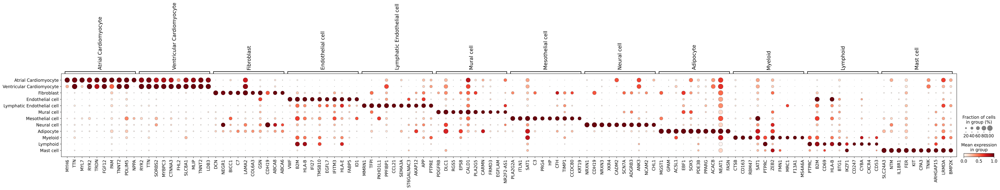

In [37]:
# DEG
sc.tl.rank_genes_groups(adata, 'cell_type', method='t-test')

def rank_genes_groups_to_df(adata, cell):
    
    dic = adata.uns['rank_genes_groups'] 
    
    df = pd.DataFrame({
        'names' : dic['names'][cell],
        'scores' : dic['scores'][cell],
        'pvals' : dic['pvals'][cell],
        'pvals_adj' : dic['pvals_adj'][cell],
        'logfoldchanges' : dic['logfoldchanges'][cell]
    })
    
    return df

DEG_dict = {}
for cluster in adata.obs['cell_type'].cat.categories:
    df=rank_genes_groups_to_df(adata, cluster)
    # select genes: significant and up-regulated ones
    df=df[(df['pvals_adj']<0.05)&(df['logfoldchanges']>0)]
    # sort based on the logFC
    df.sort_values('scores',ascending=False,inplace=True)
    DEG_dict[cluster]=list(df[:10]['names'])
    del df

sc.pl.dotplot(adata,
              DEG_dict, 
              groupby='cell_type',
              dendrogram=False,
              standard_scale="var",
              color_map="Reds",
              swap_axes=False,
             )

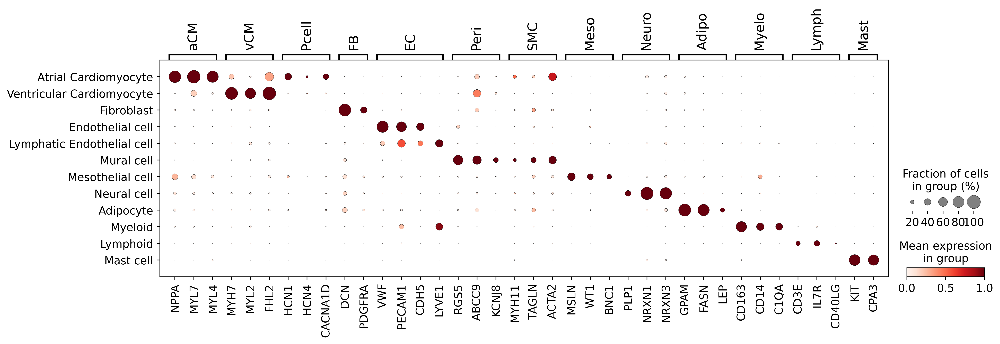

In [39]:
marker_genes_dict = {
    'aCM': ['NPPA', 'MYL7', 'MYL4'],
    'vCM': ['MYH7', 'MYL2', 'FHL2'],
    'Pcell':['HCN1','HCN4','CACNA1D'],
    'FB': ['DCN', 'GCN', 'PDGFRA'],
    'EC': ['VWF', 'PECAM1', 'CDH5','LYVE1'],
    'Peri': ['RGS5', 'ABCC9', 'KCNJ8'],
    'SMC': ['MYH11', 'TAGLN', 'ACTA2'],
    'Meso': ['MSLN', 'WT1', 'BNC1'],
    'Neuro': ['PLP1', 'NRXN1', 'NRXN3'],
    'Adipo': ['GPAM', 'FASN', 'LEP'],
    'Myelo': ['CD163','CD14', 'C1QA'],
    'Lymph': ['CD3E', 'IL7R', 'CD40LG'],
    # 'B': ['CD19','SDC1','IGHG1','IGHA1'],
    'Mast': ['KIT', 'CPA3'],
}

for k, v in marker_genes_dict.items():
    marker_genes_dict[k] = [x for x in v if x in list(adata.var_names)]

sc.pl.dotplot(adata, marker_genes_dict, 
              groupby='cell_type',
              dendrogram=False,
              standard_scale="var",
              color_map="Reds",
              save='_celltype-markers.pdf'
             # swap_axes=True
             )

In [ ]:
adata.var['gene_name_multiome-2']

In [ ]:
adata

## SAN

In [6]:
adata = sc.read_h5ad('/nfs/team205/heart/anndata_objects/8regions/CCS_annotations_full/SAN-aCM_lognorm_umap.h5ad')
adata

AnnData object with n_obs × n_vars = 9857 × 26710
    obs: 'sangerID', 'combinedID', 'donor', 'donor_type', 'region', 'region_finest', 'age', 'gender', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'flushed', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'batch_key', 'leiden_scVI', 'cell_type', 'cell_state_HCAv1', 'cell_state_scNym', 'cell_state_scNym_confidence', 'cell_state', 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'n_counts', '_scvi_batch', '_scvi_labels', 'clus20', 'doublet_cls', 'original_or_new', 'batch', 'scANVI_predictions', 'CCS_or_others'
    var: 'gene_name_scRNA-0-original', 'gene_name_snRNA-1-original', 'gene_name_multiome-2-original', 'n_cells', 'gene_id'
    uns: 'CCS_or_others_colors', '_scvi_manager_uuid', '_scvi_uuid', 'cell_state_colors', 'leiden', 'leiden_scVI

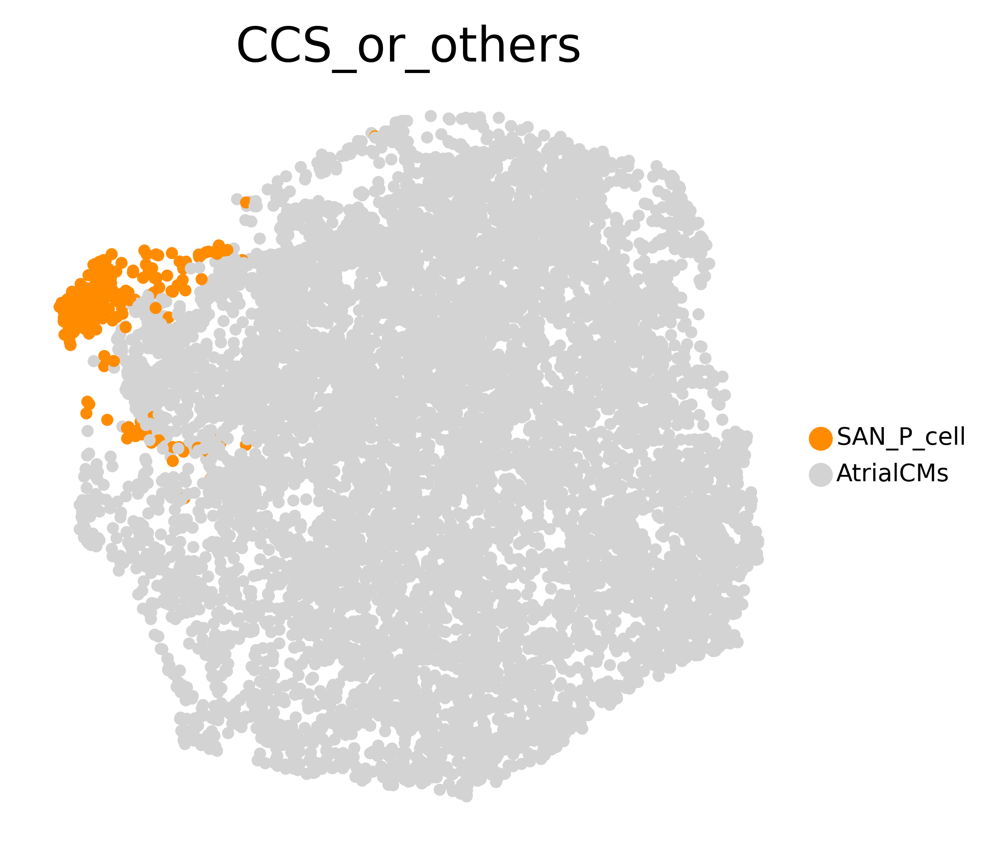

In [12]:
adata.uns["CCS_or_others_colors"][list(adata.obs['CCS_or_others'].cat.categories).index('AtrialCMs')]='lightgrey'
adata.uns["CCS_or_others_colors"][list(adata.obs['CCS_or_others'].cat.categories).index('SAN_P_cell')]='darkorange'

sc.pl.umap(adata, color=['CCS_or_others'], legend_fontsize=7, frameon=False, size=50,
               legend_fontweight='normal',save='_san.pdf',
              ) # 

## AVN - aCM

In [14]:
!ls /nfs/team205/heart/anndata_objects/8regions/CCS_annotations_full/

AVN-atrialCM_lognorm_umap.h5ad	AVN-P_index.csv
AVN-avCM_lognorm_umap.h5ad	Purkinje_index.csv
AVN-bundle_index.csv		SAN-aCM_lognorm_umap.h5ad
AVN-CMs_celltype_labels.csv	SAN-P_index.csv


In [15]:
adata = sc.read_h5ad('/nfs/team205/heart/anndata_objects/8regions/CCS_annotations_full/AVN-atrialCM_lognorm_umap.h5ad')
adata

AnnData object with n_obs × n_vars = 955 × 26624
    obs: 'sangerID', 'combinedID', 'donor', 'donor_type', 'region', 'region_finest', 'age', 'gender', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'flushed', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'batch_key', 'leiden_scVI', 'cell_type', 'cell_state_HCAv1', 'cell_state_scNym', 'cell_state_scNym_confidence', 'cell_state', 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'n_counts', '_scvi_batch', '_scvi_labels', 'clus20', 'doublet_cls', 'original_or_new', 'batch', 'scANVI_predictions', 'AVN_pre_cell_type', 'CCS_or_others'
    var: 'gene_name_scRNA-0-original', 'gene_name_snRNA-1-original', 'gene_name_multiome-2-original', 'n_cells', 'gene_id'
    uns: 'CCS_or_others_colors', '_scvi_manager_uuid', '_scvi_uuid', 'age_colors', 'cell_sta

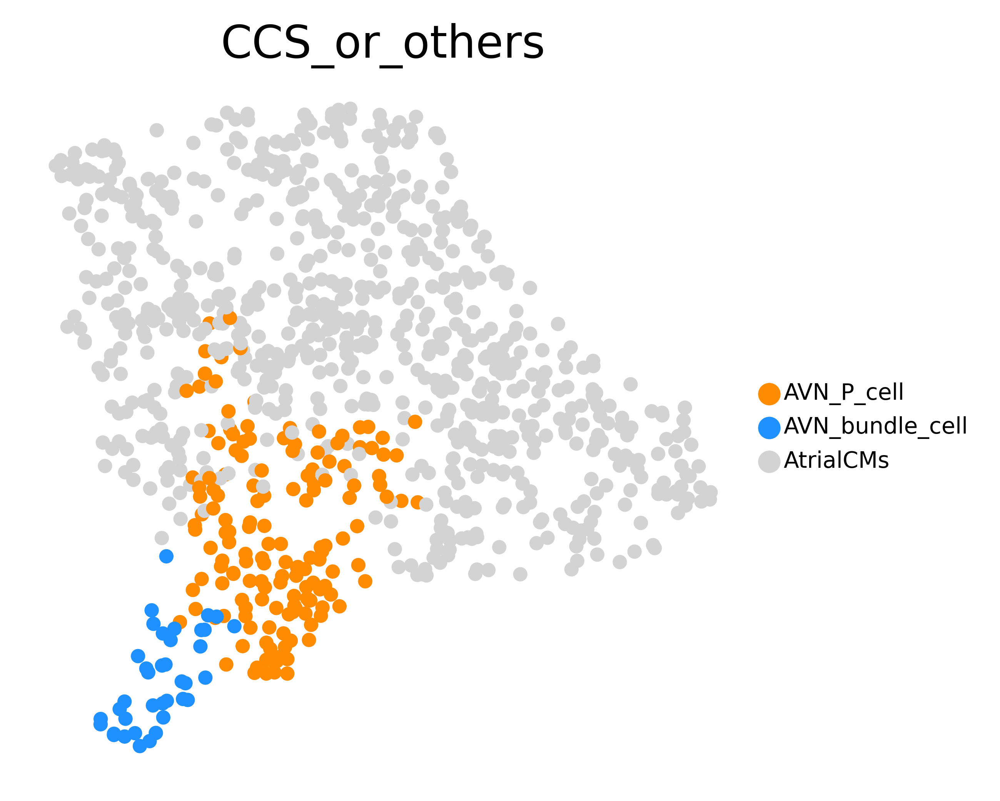

In [20]:
adata.uns["CCS_or_others_colors"][list(adata.obs['CCS_or_others'].cat.categories).index('AtrialCMs')]='lightgrey'
adata.uns["CCS_or_others_colors"][list(adata.obs['CCS_or_others'].cat.categories).index('AVN_P_cell')]='darkorange'
adata.uns["CCS_or_others_colors"][list(adata.obs['CCS_or_others'].cat.categories).index('AVN_bundle_cell')]='dodgerblue'

sc.pl.umap(adata, color=['CCS_or_others'], legend_fontsize=7, frameon=False, size=80,
               legend_fontweight='normal',save='_avn.pdf',
              ) # 

## AVN - avCM

In [22]:
adata = sc.read_h5ad('/nfs/team205/heart/anndata_objects/8regions/CCS_annotations_full/AVN-avCM_lognorm_umap.h5ad')
adata

AnnData object with n_obs × n_vars = 15618 × 26624
    obs: 'sangerID', 'combinedID', 'donor', 'donor_type', 'region', 'region_finest', 'age', 'gender', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'flushed', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'batch_key', 'leiden_scVI', 'cell_type', 'cell_state_HCAv1', 'cell_state_scNym', 'cell_state_scNym_confidence', 'cell_state', 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'n_counts', '_scvi_batch', '_scvi_labels', 'clus20', 'doublet_cls', 'original_or_new', 'batch', 'scANVI_predictions', 'AVN_pre_cell_type', 'CCS_or_others'
    var: 'gene_name_scRNA-0-original', 'gene_name_snRNA-1-original', 'gene_name_multiome-2-original', 'n_cells', 'gene_id'
    uns: 'CCS_or_others_colors', '_scvi_manager_uuid', '_scvi_uuid', 'age_colors', 'cell_s

In [24]:
adata.obs['cell_type'].value_counts()

Ventricular Cardiomyocyte    14663
Atrial Cardiomyocyte           955
Name: cell_type, dtype: int64

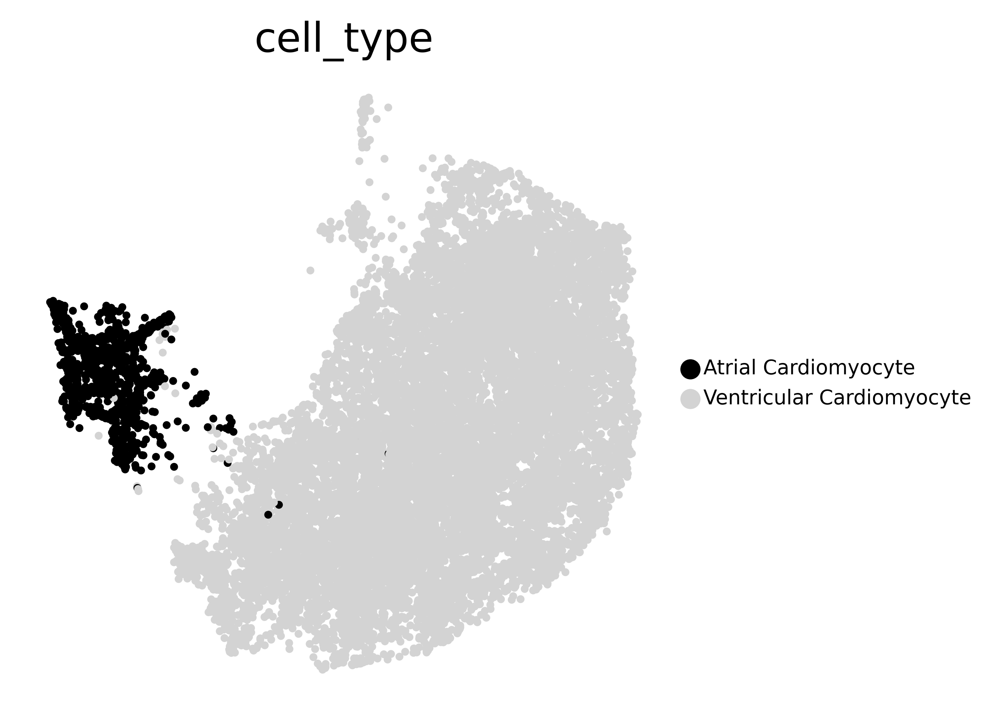

In [27]:
adata.uns["cell_type_colors"][list(adata.obs['cell_type'].cat.categories).index('Ventricular Cardiomyocyte')]='lightgrey'
adata.uns["cell_type_colors"][list(adata.obs['cell_type'].cat.categories).index('Atrial Cardiomyocyte')]='black'

sc.pl.umap(adata, color=['cell_type'], legend_fontsize=7, frameon=False, size=30,
               legend_fontweight='normal',save='_avn_avCM.pdf',
              ) # 

In [ ]:
sc.pl.umap(adata, color=['cell_state'])